In [1]:
import unittest
import os
import sys
import pathlib
import urllib
import shutil
import re
import zipfile

import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

import itertools

%load_ext autoreload
%autoreload 2

test = unittest.TestCase()
plt.rcParams.update({'font.size': 12})
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)

Using device: cuda


In [22]:
import torchvision.transforms as T
from torchvision.datasets import ImageFolder
import PIL.Image as Image

im_size = 256
tf = T.Compose([
    # Resize to constant spatial dimensions
    T.Resize((im_size, im_size)),
    # PIL.Image -> torch.Tensor
    T.ToTensor(),
    # Dynamic range [0,1] -> [-1, 1]
    T.Normalize(mean=(.5,.5,.5), std=(.5,.5,.5)),
])

class CustomDataSet(torch.utils.data.Dataset):
    def __init__(self, dirA, dirB, transform, subset_length=1500, random=True):
        self.dirA = dirA
        self.dirB = dirB
        self.transform = transform
        self.imgsA = os.listdir(dirA)
        self.imgsB = os.listdir(dirB)
        self.subset_length = subset_length
        self.random = random
        self.length = len(self.imgsA) * len(self.imgsB)
#         self.total_imgs = natsort.natsorted(all_imgs)

    def __len__(self):
#         return len(self.imgsA) * len(self.imgsB)
        return self.subset_length

    def __getitem__(self, idx):
        if self.random:
            idx = np.random.randint(0,self.length - 1)
        idx1 = idx // len(self.imgsB)
        idx2 = idx % len(self.imgsB)
        
        img_locA = os.path.join(self.dirA, self.imgsA[idx1])
        img_locB = os.path.join(self.dirB, self.imgsB[idx2])
        imageA = Image.open(img_locA).convert("RGB")
        imageB = Image.open(img_locB).convert("RGB")
        tensor_imageA = self.transform(imageA)
        tensor_imageB = self.transform(imageB)
        return tensor_imageA, tensor_imageB

In [23]:
import util.plot as plot
import util.download

DATA_DIR = pathlib.Path.home().joinpath('.pytorch-datasets')
dd = DATA_DIR.joinpath('monet2photo').joinpath('trainA')
os.path.abspath(dd)

# dsPhoto = CustomDataSet(os.path.abspath(DATA_DIR.joinpath('monet2photo').joinpath('trainB')), transform=tf)
# dsMonet = CustomDataSet(os.path.abspath(DATA_DIR.joinpath('monet2photo').joinpath('trainA')), transform=tf)
ds = CustomDataSet(
    os.path.abspath(DATA_DIR.joinpath('monet2photo').joinpath('trainB')),
    os.path.abspath(DATA_DIR.joinpath('monet2photo').joinpath('trainA')),
    transform=tf)

Found 1500 images in dataset folder.


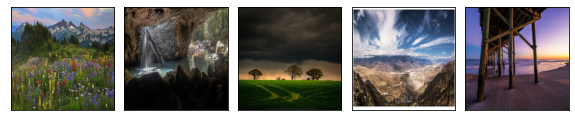

In [24]:
_ = plot.dataset_first_n(ds, 5, figsize=(10,5), nrows=1)
print(f'Found {len(ds)} images in dataset folder.')

In [25]:
import cyclegan as gan

print("### Image size")
x0, y0 = ds[0]
x0 = x0.unsqueeze(0).to(device)
print(x0.shape)

print("#### Discriminator")
dsc = gan.PatchGANDiscriminator(input_nc=3).to(device)
print(dsc)

print("### Discriminator output shape")
d0 = dsc(x0)
print(d0.shape)

### Image size
torch.Size([1, 3, 256, 256])
#### Discriminator
PatchGANDiscriminator(
  (model): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
  )
)
### Dis

In [26]:
print("### Generator")
gen = gan.ResnetGenerator().to(device)
print(gen)

print("### Generator output shape")
xr = gen(x0)
print(xr.shape)

### Generator
ResnetGenerator(
  (model): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (3): ReLU(inplace=True)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (9): ReLU(inplace=True)
    (10): ResnetBlock(
      (conv_block): Sequential(
        (0): ReflectionPad2d((1, 1, 1, 1))
        (1): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), bias=False)
        (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (3): ReLU(inplace=True)
        (4): ReflectionPad2

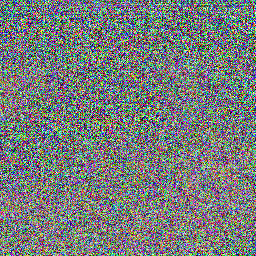

In [27]:
# _ = plot.tensors_as_images(xr.cpu())
T.ToPILImage()(xr.cpu().squeeze())

In [28]:
from torch.utils.data import DataLoader
dl_train = DataLoader(ds, 1, shuffle=True)

(<Figure size 576x576 with 2 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fdcb0c37bd0>,
       dtype=object))

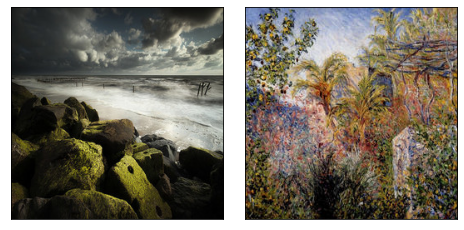

In [29]:
x_real, y_real = next(iter(dl_train))
plot.tensors_as_images([x_real.squeeze(), y_real.squeeze()])

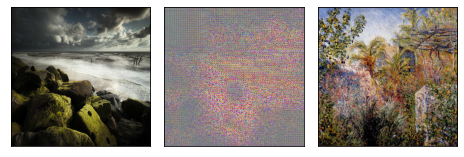

In [30]:
y_fake = gen(x_real.cuda()).cpu()
t_to_display = torch.cat([x_real.cpu(), y_fake.cpu(), y_real.cpu()])
fig, _ = plot.tensors_as_images(t_to_display.detach())#figsize=(6,2))

In [31]:
import torch.optim as optim
from torch.utils.data import DataLoader

torch.manual_seed(999)

# Hyperparams
hp = dict(
        batch_size=1, data_label=1, lam=10, lam_idt=1,
        discriminator_optimizer=dict(
            type='Adam', 
            lr=0.0002,
            weight_decay=0.02,
            betas=(0.5, 0.999)
        ),
        generator_optimizer=dict(
            type='Adam',  
            lr=0.0002,
            weight_decay=0.02,
            betas=(0.5, 0.999)
        ),
    )
    

# Data
dl_train = DataLoader(ds, hp['batch_size'], shuffle=True)
im_size = ds[0][0].shape

# Model
dscX, dscY = gan.PatchGANDiscriminator(im_size[0]).to(device), gan.PatchGANDiscriminator(im_size[0]).to(device)
genXY, genYX = gan.ResnetGenerator().to(device), gan.ResnetGenerator().to(device)

# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if hasattr(m, 'weight') and (classname.find('Conv') != -1 or classname.find('Linear') != -1):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
        
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
genXY.apply(weights_init)
genYX.apply(weights_init)
dscX.apply(weights_init)
dscY.apply(weights_init)

# Optimizer
def create_optimizer(model_params, opt_params):
    opt_params = opt_params.copy()
    optimizer_type = opt_params['type']
    opt_params.pop('type')
    return optim.__dict__[optimizer_type](model_params, **opt_params)

dsc_optimizer = create_optimizer(itertools.chain(dscX.parameters(), dscY.parameters()), hp['discriminator_optimizer'])
gen_optimizer = create_optimizer(itertools.chain(genXY.parameters(), genYX.parameters()), hp['generator_optimizer'])

    
# Loss
def dsc_loss_fn(y_data, y_generated):
    return gan.discriminator_loss_fn(y_data, y_generated, hp['data_label'])

def gen_loss_fn(y_generated):
    return gan.generator_loss_fn(y_generated, hp['data_label'])

def cyc_consistency_loss_fn(x,xyx_generated):
    return gan.cycle_consistency_loss_fn(x, xyx_generated, hp['lam'])

def idt_loss_fn(x, x_idt):
    return gan.idtentity_loss_fn(x, x_idt, hp['lam_idt'])

# Training
checkpoint_file = 'checkpoints/cycgan'
checkpoint_file_final = f'{checkpoint_file}_final'
if os.path.isfile(f'{checkpoint_file}.pt'):
    os.remove(f'{checkpoint_file}.pt')

# Show hypers
print(hp)

{'batch_size': 1, 'data_label': 1, 'lam': 10, 'lam_idt': 1, 'discriminator_optimizer': {'type': 'Adam', 'lr': 0.0002, 'weight_decay': 0.02, 'betas': (0.5, 0.999)}, 'generator_optimizer': {'type': 'Adam', 'lr': 0.0002, 'weight_decay': 0.02, 'betas': (0.5, 0.999)}}


--- EPOCH 1/5 ---
  0%|          | 1/1500 [00:01<39:19,  1.57s/it]
Discriminator X loss: 0.3830932080745697
Discriminator Y loss: 0.3121952414512634
Generator loss:     6.834081172943115


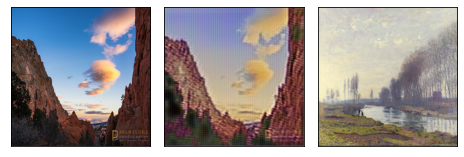

  3%|▎         | 51/1500 [01:15<35:36,  1.47s/it]
Discriminator X loss: 0.4618680504899399
Discriminator Y loss: 0.4291095917715746
Generator loss:     6.909144177156336


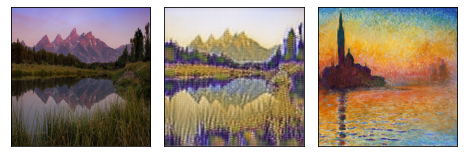

  7%|▋         | 101/1500 [02:29<34:28,  1.48s/it]
Discriminator X loss: 0.5114345043750093
Discriminator Y loss: 0.44292313435880265
Generator loss:     6.7832626588273754


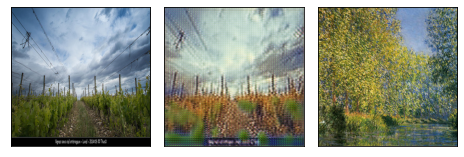

 10%|█         | 151/1500 [03:43<33:16,  1.48s/it]
Discriminator X loss: 0.5246500051672885
Discriminator Y loss: 0.4929929407227118
Generator loss:     6.821827626386225


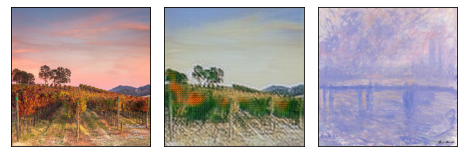

 13%|█▎        | 201/1500 [04:58<32:12,  1.49s/it]
Discriminator X loss: 0.5103861128735305
Discriminator Y loss: 0.49101163810165366
Generator loss:     6.805435852031803


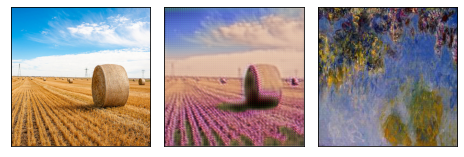

 17%|█▋        | 251/1500 [06:12<31:02,  1.49s/it]
Discriminator X loss: 0.5027920731391565
Discriminator Y loss: 0.4942521422032816
Generator loss:     6.7824406414867875


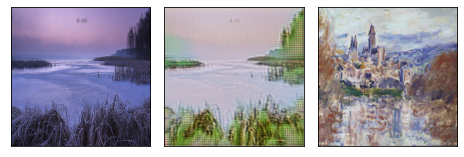

 20%|██        | 301/1500 [07:27<29:46,  1.49s/it]
Discriminator X loss: 0.5080987393757037
Discriminator Y loss: 0.48423756896657405
Generator loss:     6.75482468906035


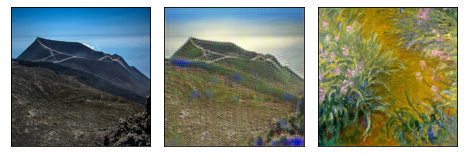

 23%|██▎       | 351/1500 [08:42<28:39,  1.50s/it]
Discriminator X loss: 0.5055900747195269
Discriminator Y loss: 0.47777710129053164
Generator loss:     6.772642410039222


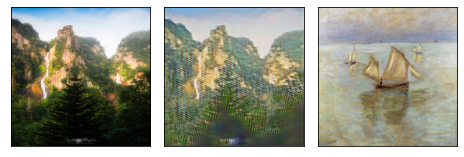

 27%|██▋       | 401/1500 [09:58<27:27,  1.50s/it]
Discriminator X loss: 0.5053505484302739
Discriminator Y loss: 0.4869258614103693
Generator loss:     6.77004112804917


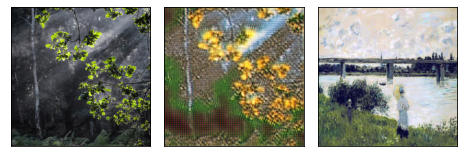

 30%|███       | 451/1500 [11:13<26:15,  1.50s/it]
Discriminator X loss: 0.509927569498244
Discriminator Y loss: 0.47644549507457773
Generator loss:     6.806380298343836


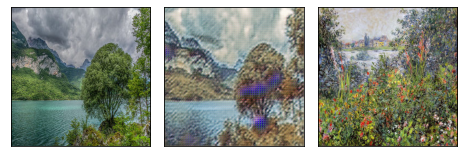

 33%|███▎      | 501/1500 [12:28<25:01,  1.50s/it]
Discriminator X loss: 0.510014953311094
Discriminator Y loss: 0.4795069188147248
Generator loss:     6.840469550705717


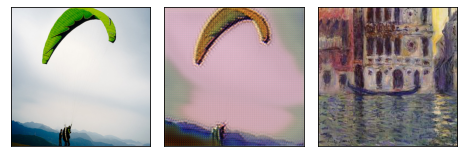

 37%|███▋      | 551/1500 [13:44<23:51,  1.51s/it]
Discriminator X loss: 0.5107895200514317
Discriminator Y loss: 0.4778659502331661
Generator loss:     6.905536197274653


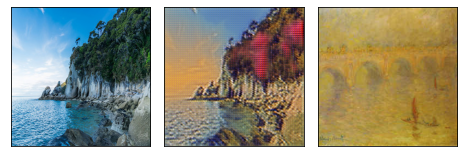

 40%|████      | 601/1500 [14:59<22:35,  1.51s/it]
Discriminator X loss: 0.5075093142551907
Discriminator Y loss: 0.47975144676628606
Generator loss:     6.940765745032845


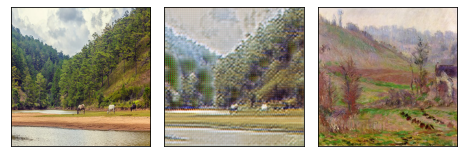

 43%|████▎     | 651/1500 [16:15<21:18,  1.51s/it]
Discriminator X loss: 0.506077120312348
Discriminator Y loss: 0.48052060644152345
Generator loss:     6.946278393360144


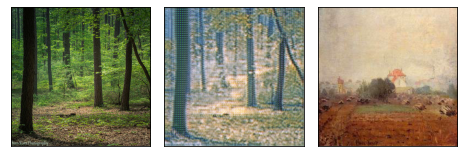

 47%|████▋     | 701/1500 [17:31<20:03,  1.51s/it]
Discriminator X loss: 0.505348971987757
Discriminator Y loss: 0.4747134082540126
Generator loss:     6.94817457321537


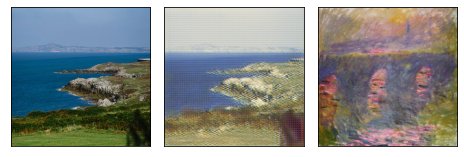

 50%|█████     | 751/1500 [18:46<18:49,  1.51s/it]
Discriminator X loss: 0.5063426925759817
Discriminator Y loss: 0.4769556616617741
Generator loss:     6.923980156051494


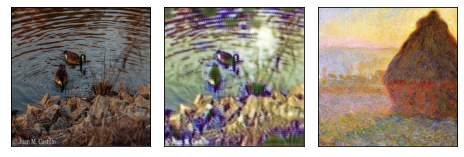

 53%|█████▎    | 801/1500 [20:02<17:34,  1.51s/it]
Discriminator X loss: 0.5059392117568468
Discriminator Y loss: 0.4747438709369015
Generator loss:     6.950709124480592


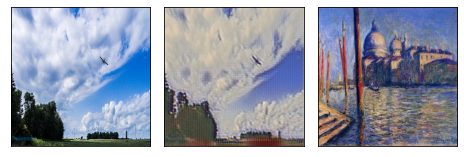

 57%|█████▋    | 851/1500 [21:18<16:17,  1.51s/it]
Discriminator X loss: 0.5046026111349516
Discriminator Y loss: 0.47597409926626294
Generator loss:     6.968342231387397


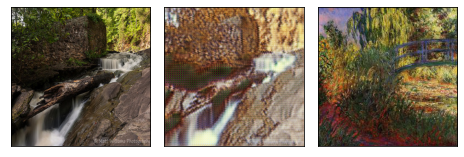

 60%|██████    | 901/1500 [22:33<15:06,  1.51s/it]
Discriminator X loss: 0.5047785108712617
Discriminator Y loss: 0.4767591289092645
Generator loss:     6.94934219684241


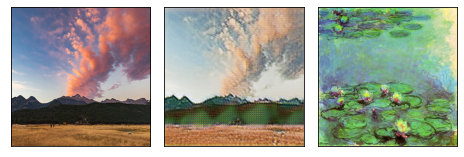

 63%|██████▎   | 951/1500 [23:49<13:45,  1.50s/it]
Discriminator X loss: 0.5035807392731325
Discriminator Y loss: 0.4791069413240525
Generator loss:     6.935606349780607


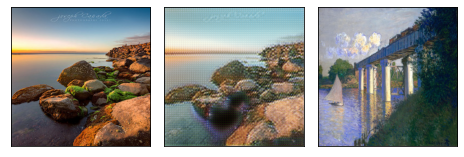

 67%|██████▋   | 1001/1500 [25:05<12:31,  1.51s/it]
Discriminator X loss: 0.5015523946145317
Discriminator Y loss: 0.475766441435902
Generator loss:     6.935734696917005


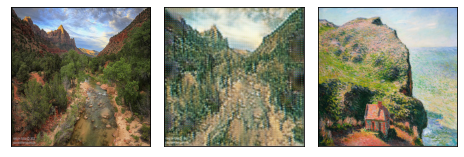

 70%|███████   | 1051/1500 [26:20<11:15,  1.51s/it]
Discriminator X loss: 0.5010546236365438
Discriminator Y loss: 0.4734290402620095
Generator loss:     6.9160654587931685


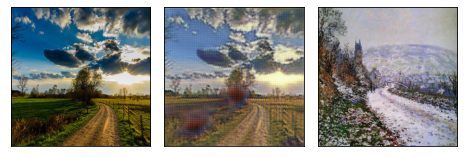

 73%|███████▎  | 1101/1500 [27:36<10:01,  1.51s/it]
Discriminator X loss: 0.5016410487224361
Discriminator Y loss: 0.4737907665207319
Generator loss:     6.90672979952529


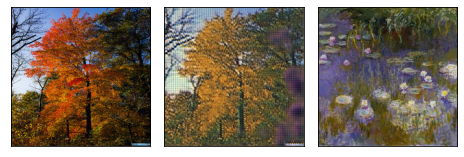

 77%|███████▋  | 1151/1500 [28:52<08:45,  1.51s/it]
Discriminator X loss: 0.5013827522884857
Discriminator Y loss: 0.4745262724344985
Generator loss:     6.887332024313283


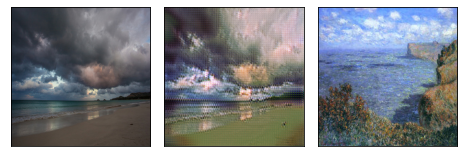

 80%|████████  | 1201/1500 [30:07<07:31,  1.51s/it]
Discriminator X loss: 0.5019026743519515
Discriminator Y loss: 0.4725692138993968
Generator loss:     6.885626728985331


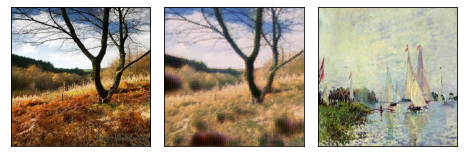

 83%|████████▎ | 1251/1500 [31:23<06:15,  1.51s/it]
Discriminator X loss: 0.5043433645753552
Discriminator Y loss: 0.47144662975359686
Generator loss:     6.87825457369395


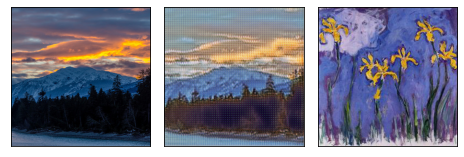

 87%|████████▋ | 1301/1500 [32:39<04:59,  1.51s/it]
Discriminator X loss: 0.5034170956690892
Discriminator Y loss: 0.4708315607140286
Generator loss:     6.884131624000426


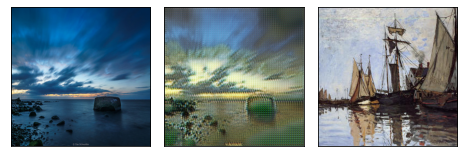

 90%|█████████ | 1351/1500 [33:55<03:44,  1.50s/it]
Discriminator X loss: 0.5024262800768602
Discriminator Y loss: 0.4714644512176778
Generator loss:     6.884013343263255


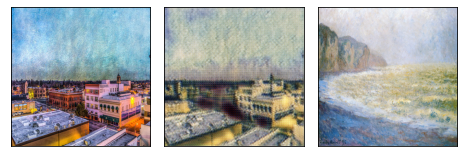

 93%|█████████▎| 1401/1500 [35:10<02:29,  1.51s/it]
Discriminator X loss: 0.5021492536422357
Discriminator Y loss: 0.47152088489449934
Generator loss:     6.884401657681734


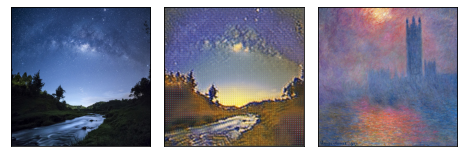

 97%|█████████▋| 1451/1500 [36:26<01:13,  1.50s/it]
Discriminator X loss: 0.5017312688099607
Discriminator Y loss: 0.47111135465494114
Generator loss:     6.878013991718042


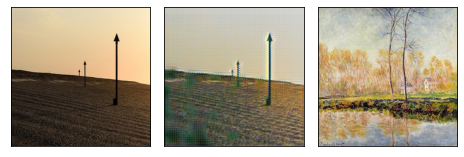

100%|██████████| 1500/1500 [37:40<00:00,  1.51s/it]
Discriminator X loss: 0.5016601445376873
Discriminator Y loss: 0.4709940836528937
Generator loss:     6.864806801478068
Saved checkpoint.
--- EPOCH 2/5 ---
  0%|          | 1/1500 [00:01<37:29,  1.50s/it]
Discriminator X loss: 0.6021763682365417
Discriminator Y loss: 0.28930333256721497
Generator loss:     6.911254405975342


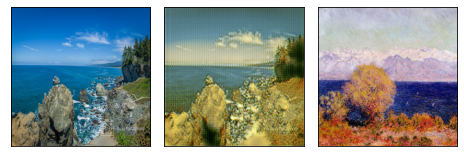

  3%|▎         | 51/1500 [01:17<36:26,  1.51s/it]
Discriminator X loss: 0.5317151438371808
Discriminator Y loss: 0.5519957069088431
Generator loss:     6.44280330807555


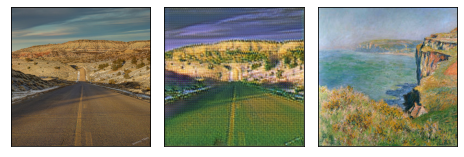

  7%|▋         | 101/1500 [02:33<35:10,  1.51s/it]
Discriminator X loss: 0.5202846670209771
Discriminator Y loss: 0.5270009203122394
Generator loss:     6.70489780501564


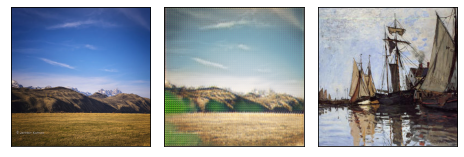

 10%|█         | 151/1500 [03:48<34:02,  1.51s/it]
Discriminator X loss: 0.5025771827689859
Discriminator Y loss: 0.5017779576067893
Generator loss:     6.707196883018443


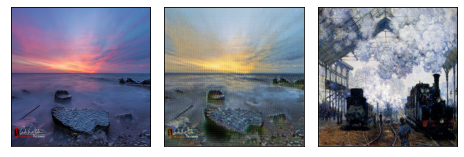

 13%|█▎        | 201/1500 [05:04<32:41,  1.51s/it]
Discriminator X loss: 0.4982520068314538
Discriminator Y loss: 0.5083889337024878
Generator loss:     6.570415563251249


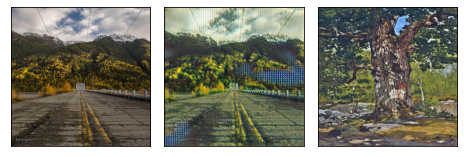

 17%|█▋        | 251/1500 [06:20<31:29,  1.51s/it]
Discriminator X loss: 0.4986594996723046
Discriminator Y loss: 0.5048963456930392
Generator loss:     6.514314053068123


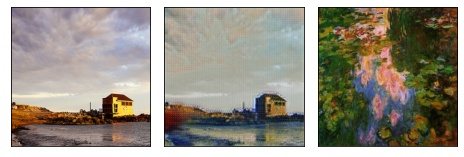

 20%|██        | 301/1500 [07:35<30:01,  1.50s/it]
Discriminator X loss: 0.5119593308316512
Discriminator Y loss: 0.5016039104705237
Generator loss:     6.568641895471617


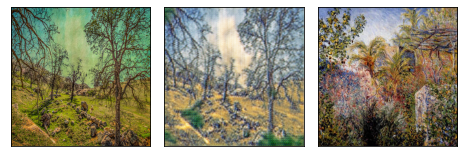

 23%|██▎       | 351/1500 [08:51<28:46,  1.50s/it]
Discriminator X loss: 0.50554973905922
Discriminator Y loss: 0.4972644499012208
Generator loss:     6.533787844187853


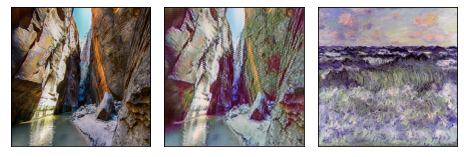

 27%|██▋       | 401/1500 [10:07<27:45,  1.52s/it]
Discriminator X loss: 0.5102076952594177
Discriminator Y loss: 0.4936740207961967
Generator loss:     6.575852742516192


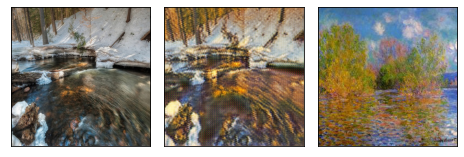

 30%|███       | 451/1500 [11:22<26:20,  1.51s/it]
Discriminator X loss: 0.5102605969209364
Discriminator Y loss: 0.4935737604940281
Generator loss:     6.598383764998611


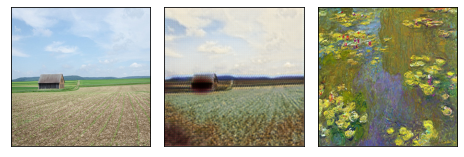

 33%|███▎      | 501/1500 [12:38<25:03,  1.50s/it]
Discriminator X loss: 0.5086483979623713
Discriminator Y loss: 0.4978539852979416
Generator loss:     6.652019713929075


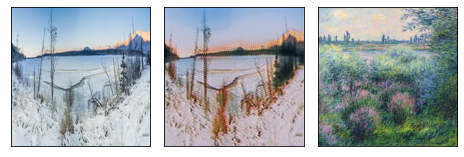

 37%|███▋      | 551/1500 [13:54<23:48,  1.51s/it]
Discriminator X loss: 0.5037053064485427
Discriminator Y loss: 0.49453695134653586
Generator loss:     6.643017248752545


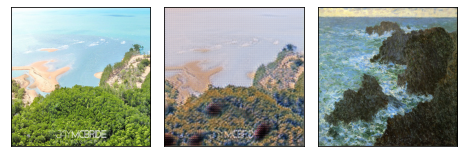

 40%|████      | 601/1500 [15:09<22:34,  1.51s/it]
Discriminator X loss: 0.5118031463959253
Discriminator Y loss: 0.49945340475405314
Generator loss:     6.646117953016437


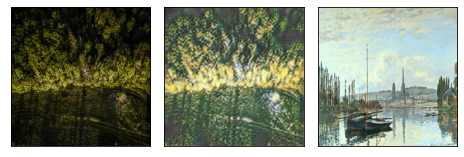

 43%|████▎     | 651/1500 [16:25<21:20,  1.51s/it]
Discriminator X loss: 0.5103549107954982
Discriminator Y loss: 0.49664712276098
Generator loss:     6.625668105991205


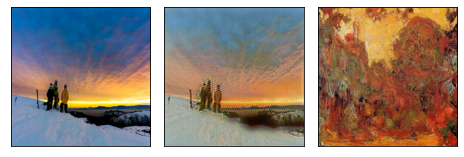

 47%|████▋     | 701/1500 [17:41<20:04,  1.51s/it]
Discriminator X loss: 0.5120670749844396
Discriminator Y loss: 0.49332895599698884
Generator loss:     6.620297406097282


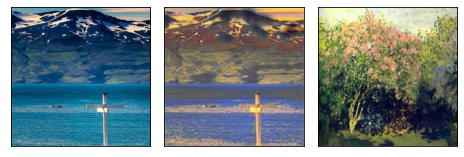

 50%|█████     | 751/1500 [18:56<18:47,  1.50s/it]
Discriminator X loss: 0.5093718921832651
Discriminator Y loss: 0.4893795003923532
Generator loss:     6.64928130620964


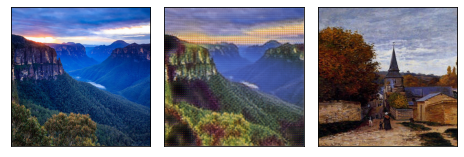

 53%|█████▎    | 801/1500 [20:12<17:32,  1.51s/it]
Discriminator X loss: 0.5091313037849247
Discriminator Y loss: 0.48862253969416636
Generator loss:     6.642902715971109


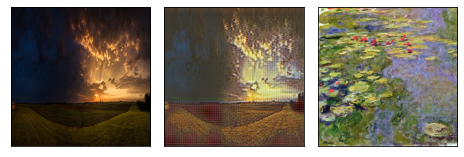

 57%|█████▋    | 851/1500 [21:28<16:17,  1.51s/it]
Discriminator X loss: 0.5095389399034016
Discriminator Y loss: 0.48751577578231114
Generator loss:     6.646758540116522


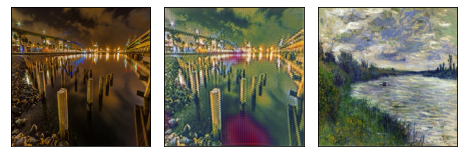

 60%|██████    | 901/1500 [22:43<15:01,  1.51s/it]
Discriminator X loss: 0.5085166811149208
Discriminator Y loss: 0.4859501387134244
Generator loss:     6.636885834057773


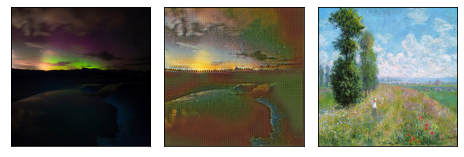

 63%|██████▎   | 951/1500 [23:59<13:49,  1.51s/it]
Discriminator X loss: 0.5092445665698196
Discriminator Y loss: 0.4858840696051419
Generator loss:     6.618690229991508


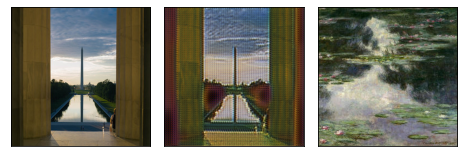

 67%|██████▋   | 1001/1500 [25:15<12:32,  1.51s/it]
Discriminator X loss: 0.5068115910718015
Discriminator Y loss: 0.48710545337015576
Generator loss:     6.592556583774197


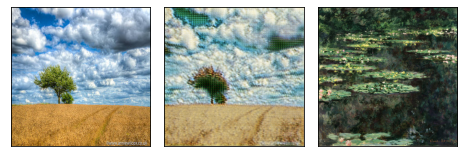

 70%|███████   | 1051/1500 [26:30<11:17,  1.51s/it]
Discriminator X loss: 0.5048670078407119
Discriminator Y loss: 0.4912933114947987
Generator loss:     6.595023257294573


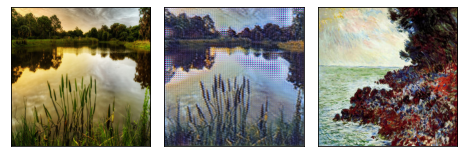

 73%|███████▎  | 1101/1500 [27:46<10:02,  1.51s/it]
Discriminator X loss: 0.5060275047611476
Discriminator Y loss: 0.4918841032834079
Generator loss:     6.610392204530665


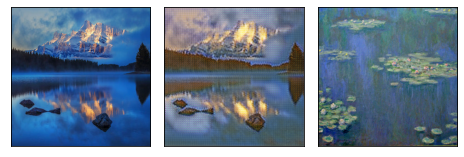

 77%|███████▋  | 1151/1500 [29:02<08:46,  1.51s/it]
Discriminator X loss: 0.5060212311410158
Discriminator Y loss: 0.4911004351816107
Generator loss:     6.625930704519503


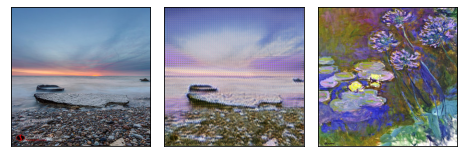

 80%|████████  | 1201/1500 [30:18<07:32,  1.51s/it]
Discriminator X loss: 0.5051665440834532
Discriminator Y loss: 0.4913875355162688
Generator loss:     6.6146189388287855


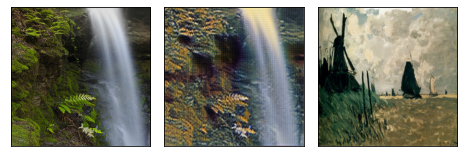

 83%|████████▎ | 1251/1500 [31:33<06:17,  1.52s/it]
Discriminator X loss: 0.5049449940808386
Discriminator Y loss: 0.49095330217020877
Generator loss:     6.604446707107275


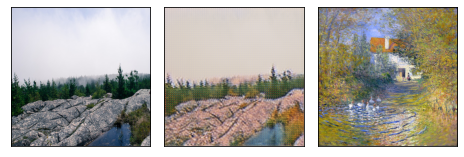

 87%|████████▋ | 1301/1500 [32:49<04:59,  1.50s/it]
Discriminator X loss: 0.5059775866161484
Discriminator Y loss: 0.49203221891061055
Generator loss:     6.595984769545547


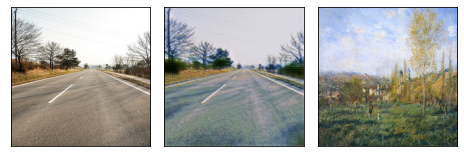

 90%|█████████ | 1351/1500 [34:05<03:44,  1.51s/it]
Discriminator X loss: 0.5048558317748023
Discriminator Y loss: 0.49095465275951883
Generator loss:     6.592512522689684


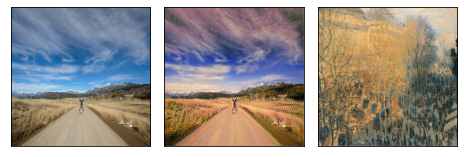

 93%|█████████▎| 1401/1500 [35:20<02:28,  1.50s/it]
Discriminator X loss: 0.5065042093970535
Discriminator Y loss: 0.4922794754551105
Generator loss:     6.602222593574333


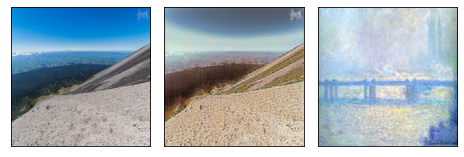

 97%|█████████▋| 1451/1500 [36:36<01:13,  1.50s/it]
Discriminator X loss: 0.5067600265227459
Discriminator Y loss: 0.4918187074491601
Generator loss:     6.5910133881703645


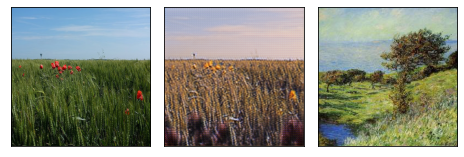

100%|██████████| 1500/1500 [37:50<00:00,  1.51s/it]
Discriminator X loss: 0.505625136996309
Discriminator Y loss: 0.4910337583621343
Generator loss:     6.581674947738647
Saved checkpoint.
--- EPOCH 3/5 ---
  0%|          | 1/1500 [00:01<37:29,  1.50s/it]
Discriminator X loss: 0.3189275860786438
Discriminator Y loss: 0.6010748147964478
Generator loss:     5.72496223449707


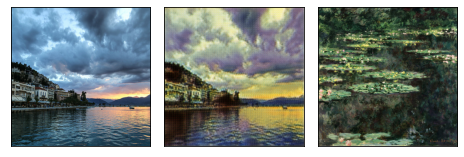

  3%|▎         | 51/1500 [01:17<36:31,  1.51s/it]
Discriminator X loss: 0.5028249527893814
Discriminator Y loss: 0.5142405674445862
Generator loss:     6.557588259379069


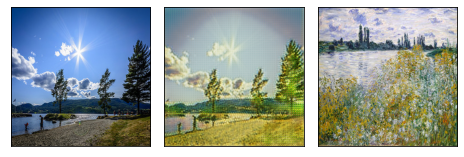

  7%|▋         | 101/1500 [02:32<35:04,  1.50s/it]
Discriminator X loss: 0.5066087441057852
Discriminator Y loss: 0.5188124584827093
Generator loss:     6.534687802343085


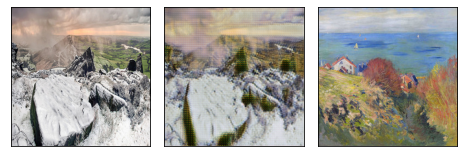

 10%|█         | 151/1500 [03:48<33:56,  1.51s/it]
Discriminator X loss: 0.4886133953780923
Discriminator Y loss: 0.4971694701061343
Generator loss:     6.566271399820088


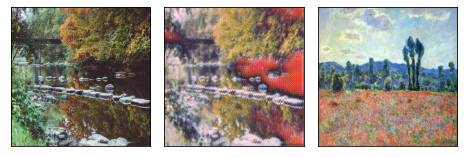

 13%|█▎        | 201/1500 [05:04<32:43,  1.51s/it]
Discriminator X loss: 0.48519874677358577
Discriminator Y loss: 0.49422607600540663
Generator loss:     6.566276551479131


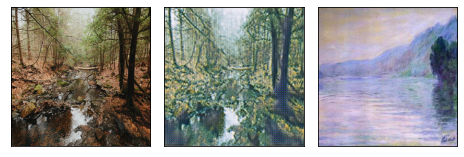

 17%|█▋        | 251/1500 [06:19<31:21,  1.51s/it]
Discriminator X loss: 0.48752574324311015
Discriminator Y loss: 0.4845500023538373
Generator loss:     6.585201908392735


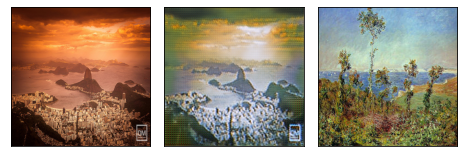

 20%|██        | 301/1500 [07:35<30:03,  1.50s/it]
Discriminator X loss: 0.48415590838785977
Discriminator Y loss: 0.4846753634735199
Generator loss:     6.503381216644844


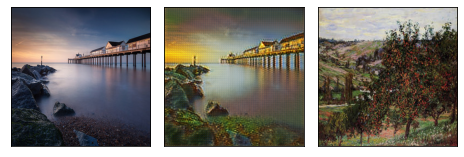

 23%|██▎       | 351/1500 [08:50<28:53,  1.51s/it]
Discriminator X loss: 0.48453990424163323
Discriminator Y loss: 0.4875722065822691
Generator loss:     6.589570775670543


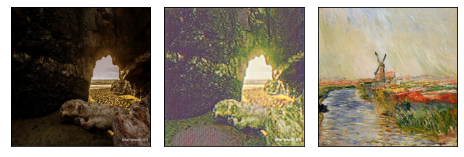

 27%|██▋       | 401/1500 [10:06<27:35,  1.51s/it]
Discriminator X loss: 0.4899939339970264
Discriminator Y loss: 0.4929273034680514
Generator loss:     6.570572554024675


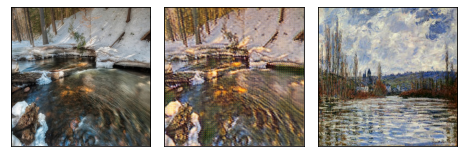

 30%|███       | 451/1500 [11:22<26:19,  1.51s/it]
Discriminator X loss: 0.49363858334538413
Discriminator Y loss: 0.4910507433099916
Generator loss:     6.558552696012341


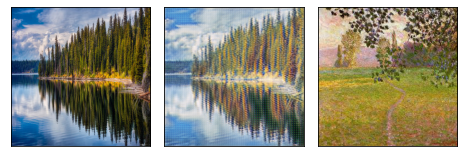

 33%|███▎      | 501/1500 [12:37<25:06,  1.51s/it]
Discriminator X loss: 0.49611100477878445
Discriminator Y loss: 0.49288886592178766
Generator loss:     6.471946169516284


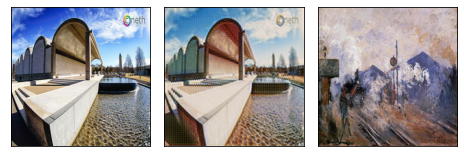

 37%|███▋      | 551/1500 [13:53<23:46,  1.50s/it]
Discriminator X loss: 0.49769158161730387
Discriminator Y loss: 0.4891555647749434
Generator loss:     6.4572436999928495


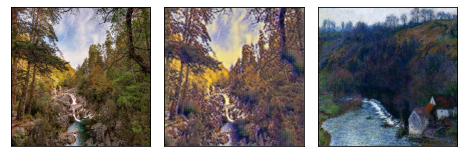

 40%|████      | 601/1500 [15:08<22:33,  1.51s/it]
Discriminator X loss: 0.49676483027178314
Discriminator Y loss: 0.49224202127851385
Generator loss:     6.453353021386856


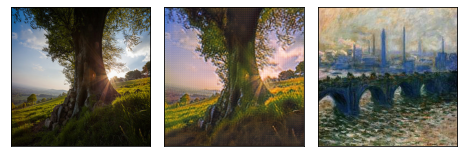

 43%|████▎     | 651/1500 [16:24<21:24,  1.51s/it]
Discriminator X loss: 0.49733638358853194
Discriminator Y loss: 0.4889005414466338
Generator loss:     6.426355486824399


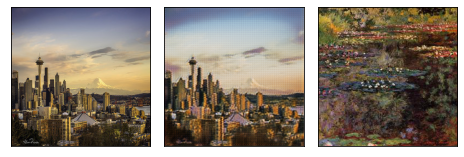

 47%|████▋     | 701/1500 [17:40<20:05,  1.51s/it]
Discriminator X loss: 0.49492109217780633
Discriminator Y loss: 0.48947610378733036
Generator loss:     6.4255482364823235


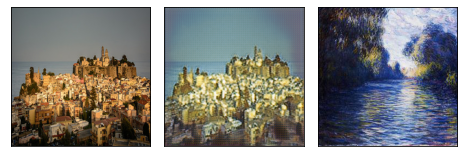

 50%|█████     | 751/1500 [18:56<18:54,  1.51s/it]
Discriminator X loss: 0.4988511351796584
Discriminator Y loss: 0.4915817234015338
Generator loss:     6.4136565388756965


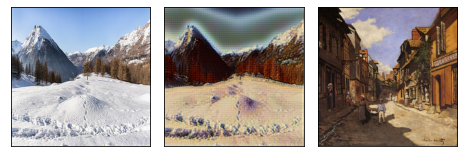

 53%|█████▎    | 801/1500 [20:12<17:33,  1.51s/it]
Discriminator X loss: 0.49767322528098107
Discriminator Y loss: 0.49647602968187665
Generator loss:     6.418571135524507


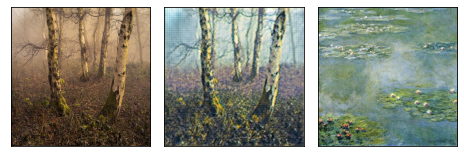

 57%|█████▋    | 851/1500 [21:27<16:22,  1.51s/it]
Discriminator X loss: 0.49797578294762573
Discriminator Y loss: 0.4984850642456291
Generator loss:     6.4030480264356635


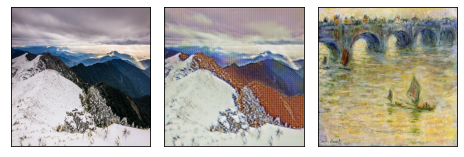

 60%|██████    | 901/1500 [22:43<15:01,  1.51s/it]
Discriminator X loss: 0.49737820309999253
Discriminator Y loss: 0.4994066983180226
Generator loss:     6.404343758783118


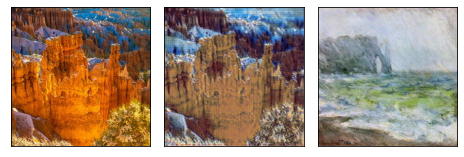

 63%|██████▎   | 951/1500 [23:59<13:47,  1.51s/it]
Discriminator X loss: 0.49575204540486717
Discriminator Y loss: 0.5013052765299595
Generator loss:     6.402690346183336


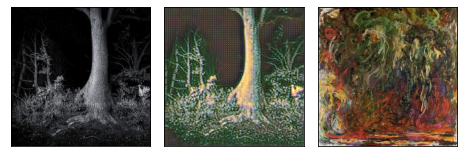

 67%|██████▋   | 1001/1500 [25:14<12:34,  1.51s/it]
Discriminator X loss: 0.4984074108689636
Discriminator Y loss: 0.5019748822509588
Generator loss:     6.41362881422281


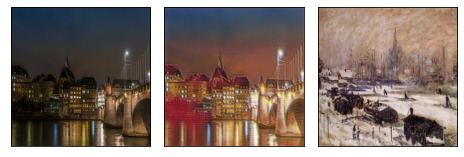

 70%|███████   | 1051/1500 [26:30<11:15,  1.50s/it]
Discriminator X loss: 0.4976937677870752
Discriminator Y loss: 0.5010705720969998
Generator loss:     6.412212974564673


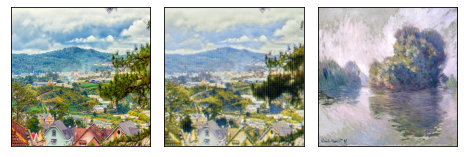

 73%|███████▎  | 1101/1500 [27:46<10:00,  1.51s/it]
Discriminator X loss: 0.4996809087165857
Discriminator Y loss: 0.5031641231110484
Generator loss:     6.407671412373542


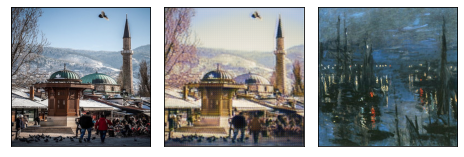

 77%|███████▋  | 1151/1500 [29:01<08:46,  1.51s/it]
Discriminator X loss: 0.500218741948531
Discriminator Y loss: 0.504037172068315
Generator loss:     6.382040711509777


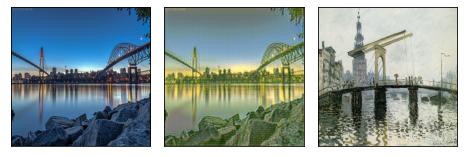

 80%|████████  | 1201/1500 [30:17<07:29,  1.50s/it]
Discriminator X loss: 0.500105032258412
Discriminator Y loss: 0.5044328933093173
Generator loss:     6.3561411213616745


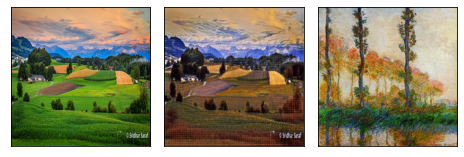

 83%|████████▎ | 1251/1500 [31:33<06:15,  1.51s/it]
Discriminator X loss: 0.4994527042942415
Discriminator Y loss: 0.5060259191502484
Generator loss:     6.347075008374038


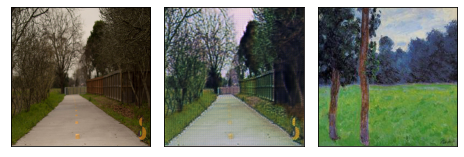

 87%|████████▋ | 1301/1500 [32:48<05:00,  1.51s/it]
Discriminator X loss: 0.4991191045154204
Discriminator Y loss: 0.5062765300354071
Generator loss:     6.346988813589391


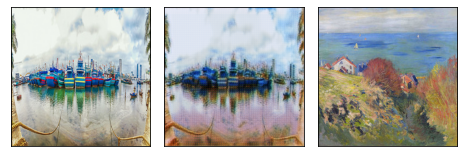

 90%|█████████ | 1351/1500 [34:04<03:44,  1.50s/it]
Discriminator X loss: 0.4996305151003586
Discriminator Y loss: 0.5058475019566048
Generator loss:     6.356666080692271


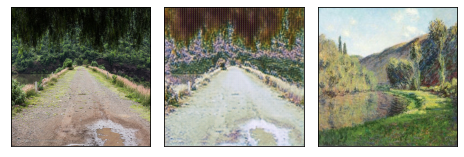

 93%|█████████▎| 1401/1500 [35:20<02:29,  1.51s/it]
Discriminator X loss: 0.5008055858984111
Discriminator Y loss: 0.508091136962069
Generator loss:     6.3489617355205095


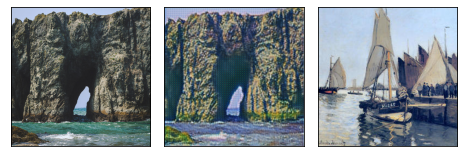

 97%|█████████▋| 1451/1500 [36:35<01:13,  1.51s/it]
Discriminator X loss: 0.4992293070573013
Discriminator Y loss: 0.5067372685009491
Generator loss:     6.342971536227541


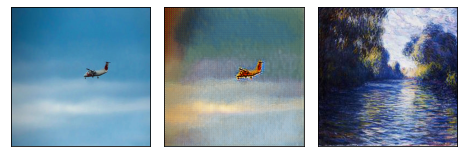

100%|██████████| 1500/1500 [37:49<00:00,  1.51s/it]
Discriminator X loss: 0.4977848267480731
Discriminator Y loss: 0.507013644317786
Generator loss:     6.334841162045796
Saved checkpoint.
--- EPOCH 4/5 ---
  0%|          | 1/1500 [00:01<37:28,  1.50s/it]
Discriminator X loss: 1.1599693298339844
Discriminator Y loss: 0.1859699785709381
Generator loss:     6.857486248016357


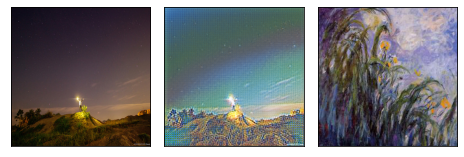

  3%|▎         | 51/1500 [01:17<36:22,  1.51s/it]
Discriminator X loss: 0.5626513905384961
Discriminator Y loss: 0.46832366959721433
Generator loss:     6.139712707669127


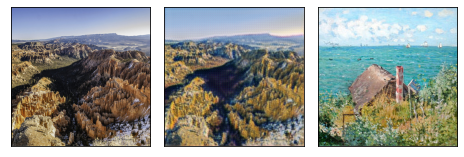

  7%|▋         | 101/1500 [02:32<35:08,  1.51s/it]
Discriminator X loss: 0.5393260512685422
Discriminator Y loss: 0.4721683116242437
Generator loss:     5.920075912286739


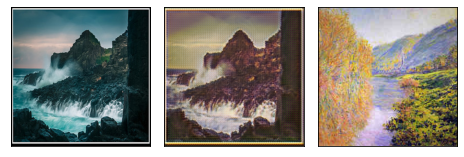

 10%|█         | 151/1500 [03:48<33:52,  1.51s/it]
Discriminator X loss: 0.5195711786729216
Discriminator Y loss: 0.4785621968523556
Generator loss:     5.7996346113697586


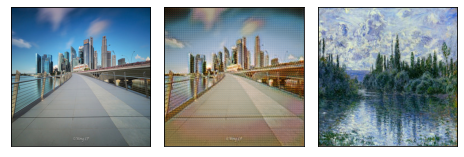

 13%|█▎        | 201/1500 [05:04<32:46,  1.51s/it]
Discriminator X loss: 0.5133084530075688
Discriminator Y loss: 0.4847542147583036
Generator loss:     5.9065121347038305


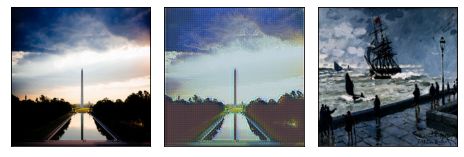

 17%|█▋        | 251/1500 [06:19<31:21,  1.51s/it]
Discriminator X loss: 0.5181051124762966
Discriminator Y loss: 0.4772235732748214
Generator loss:     6.001027205075876


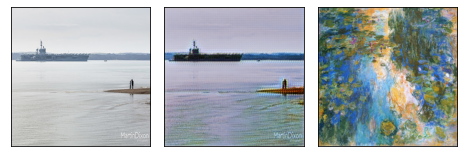

 20%|██        | 301/1500 [07:35<30:15,  1.51s/it]
Discriminator X loss: 0.509573734442756
Discriminator Y loss: 0.48095232020580886
Generator loss:     6.054716364489837


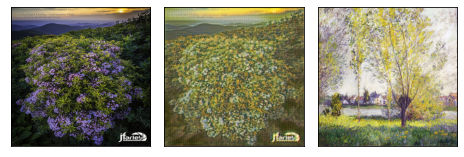

 23%|██▎       | 351/1500 [08:51<28:49,  1.51s/it]
Discriminator X loss: 0.5053551055788145
Discriminator Y loss: 0.48428293137129214
Generator loss:     6.073531268329023


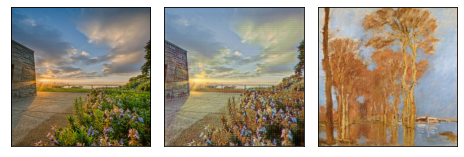

 27%|██▋       | 401/1500 [10:07<27:47,  1.52s/it]
Discriminator X loss: 0.4999573426855324
Discriminator Y loss: 0.47505742614331686
Generator loss:     6.060329455687221


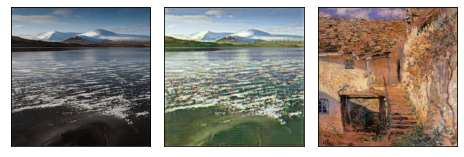

 30%|███       | 451/1500 [11:22<26:22,  1.51s/it]
Discriminator X loss: 0.5023125507135745
Discriminator Y loss: 0.4788120525936594
Generator loss:     6.050956129234804


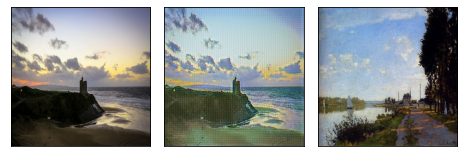

 33%|███▎      | 501/1500 [12:38<25:02,  1.50s/it]
Discriminator X loss: 0.49729204954888057
Discriminator Y loss: 0.47714925775984807
Generator loss:     6.04578592915259


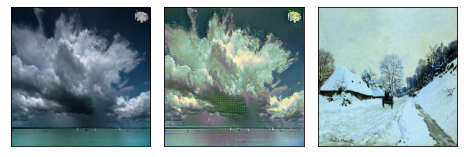

 37%|███▋      | 551/1500 [13:54<23:55,  1.51s/it]
Discriminator X loss: 0.5006043502415265
Discriminator Y loss: 0.4784885393810575
Generator loss:     6.065310818746605


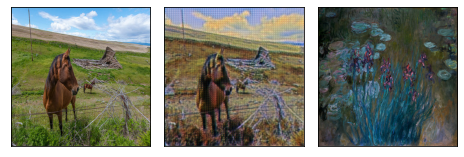

 40%|████      | 601/1500 [15:10<22:38,  1.51s/it]
Discriminator X loss: 0.5008078791548229
Discriminator Y loss: 0.4814899255972535
Generator loss:     6.032663336212742


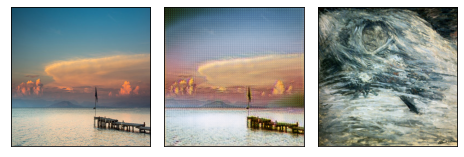

 43%|████▎     | 651/1500 [16:25<21:16,  1.50s/it]
Discriminator X loss: 0.5013202436771902
Discriminator Y loss: 0.47974369734434125
Generator loss:     6.018163783942133


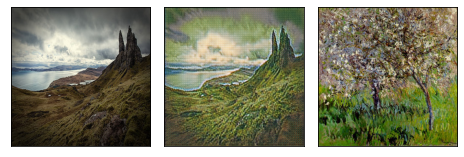

 47%|████▋     | 701/1500 [17:41<20:06,  1.51s/it]
Discriminator X loss: 0.5026474072094396
Discriminator Y loss: 0.47860285173171596
Generator loss:     6.012724095846549


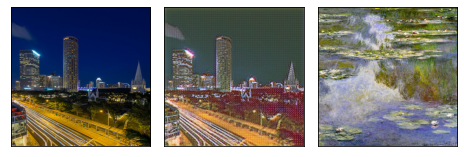

 50%|█████     | 751/1500 [18:57<18:50,  1.51s/it]
Discriminator X loss: 0.5025543334550372
Discriminator Y loss: 0.47708253078311486
Generator loss:     6.019424426730241


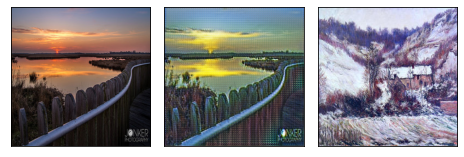

 53%|█████▎    | 801/1500 [20:12<17:32,  1.51s/it]
Discriminator X loss: 0.5005938290163744
Discriminator Y loss: 0.47891768689421976
Generator loss:     6.03491416733512


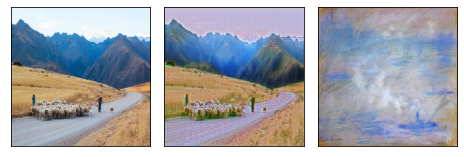

 57%|█████▋    | 851/1500 [21:28<16:17,  1.51s/it]
Discriminator X loss: 0.5032290948290032
Discriminator Y loss: 0.4809154003911097
Generator loss:     6.016497079690111


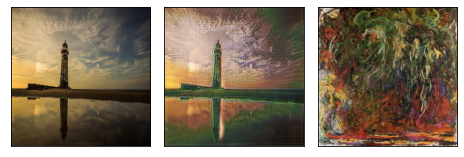

 60%|██████    | 901/1500 [22:43<15:01,  1.51s/it]
Discriminator X loss: 0.5002457063508682
Discriminator Y loss: 0.478492307866387
Generator loss:     6.01812750041551


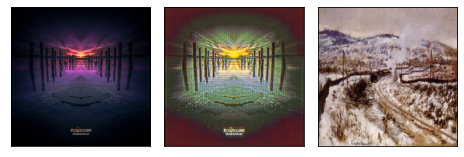

 63%|██████▎   | 951/1500 [23:59<13:46,  1.50s/it]
Discriminator X loss: 0.49944264414699674
Discriminator Y loss: 0.4770408383130902
Generator loss:     5.991208351247569


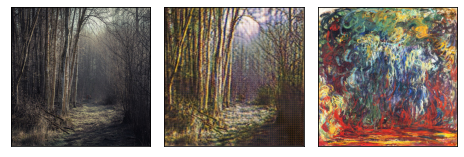

 67%|██████▋   | 1001/1500 [25:14<12:33,  1.51s/it]
Discriminator X loss: 0.4999811449585916
Discriminator Y loss: 0.47876150525741645
Generator loss:     5.975293729688738


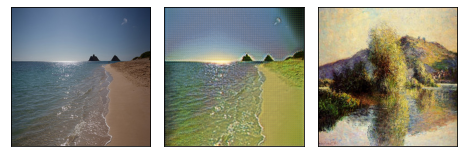

 70%|███████   | 1051/1500 [26:30<11:15,  1.50s/it]
Discriminator X loss: 0.49997211338067826
Discriminator Y loss: 0.47979281401061424
Generator loss:     5.949388172374693


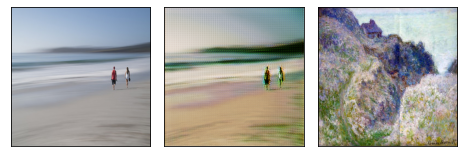

 73%|███████▎  | 1101/1500 [27:45<09:58,  1.50s/it]
Discriminator X loss: 0.50049020431523
Discriminator Y loss: 0.48043521307577985
Generator loss:     5.95046168278825


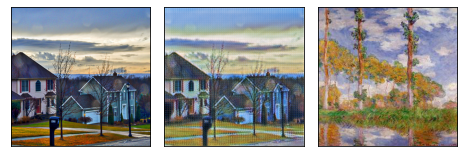

 77%|███████▋  | 1151/1500 [29:01<08:42,  1.50s/it]
Discriminator X loss: 0.5014659535984544
Discriminator Y loss: 0.48031252763718757
Generator loss:     5.940305512434084


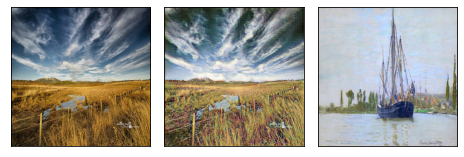

 80%|████████  | 1201/1500 [30:16<07:28,  1.50s/it]
Discriminator X loss: 0.5001365965593616
Discriminator Y loss: 0.47963859885931015
Generator loss:     5.9463211501468525


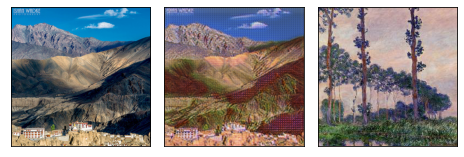

 83%|████████▎ | 1251/1500 [31:32<06:14,  1.50s/it]
Discriminator X loss: 0.5005017184197521
Discriminator Y loss: 0.47930920691632156
Generator loss:     5.946652514757298


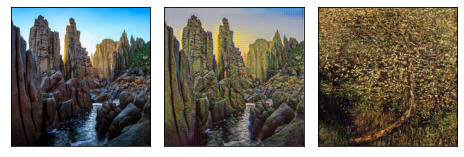

 87%|████████▋ | 1301/1500 [32:47<04:58,  1.50s/it]
Discriminator X loss: 0.5004646781685946
Discriminator Y loss: 0.4783016727016029
Generator loss:     5.956233771556529


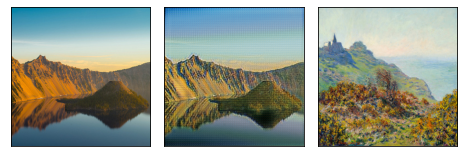

 90%|█████████ | 1351/1500 [34:02<03:43,  1.50s/it]
Discriminator X loss: 0.5004964104373087
Discriminator Y loss: 0.4786043002495582
Generator loss:     5.946677188005031


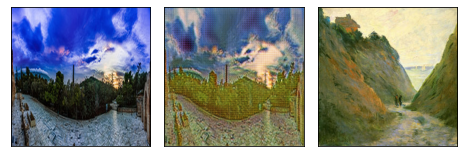

 93%|█████████▎| 1401/1500 [35:18<02:28,  1.50s/it]
Discriminator X loss: 0.5006252167231904
Discriminator Y loss: 0.4803069908488316
Generator loss:     5.93597172890962


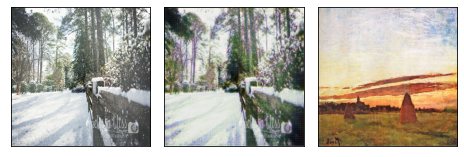

 97%|█████████▋| 1451/1500 [36:33<01:13,  1.50s/it]
Discriminator X loss: 0.4995318805371417
Discriminator Y loss: 0.48170412535157225
Generator loss:     5.924282769677066


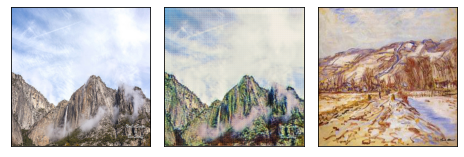

100%|██████████| 1500/1500 [37:46<00:00,  1.51s/it]
Discriminator X loss: 0.5001302524084846
Discriminator Y loss: 0.4829498710681995
Generator loss:     5.917745630423228
Saved checkpoint.
--- EPOCH 5/5 ---
  0%|          | 1/1500 [00:01<37:17,  1.49s/it]
Discriminator X loss: 0.24387387931346893
Discriminator Y loss: 0.26016509532928467
Generator loss:     5.174776554107666


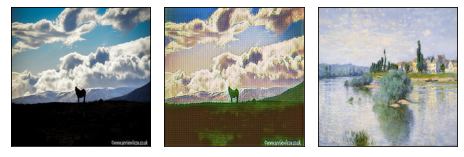

  3%|▎         | 51/1500 [01:16<36:18,  1.50s/it]
Discriminator X loss: 0.5531244426965714
Discriminator Y loss: 0.5112223794647291
Generator loss:     5.972232262293498


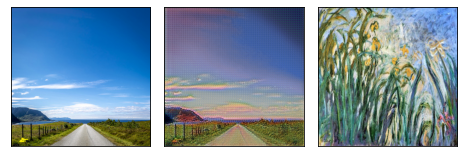

  7%|▋         | 101/1500 [02:32<34:56,  1.50s/it]
Discriminator X loss: 0.50639608738446
Discriminator Y loss: 0.49713834205476365
Generator loss:     5.887836279255329


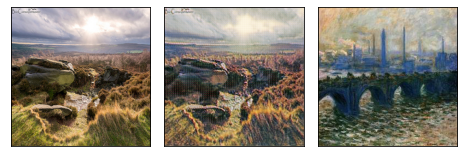

 10%|█         | 151/1500 [03:47<33:40,  1.50s/it]
Discriminator X loss: 0.499526657509488
Discriminator Y loss: 0.5278062099060475
Generator loss:     5.973109497929251


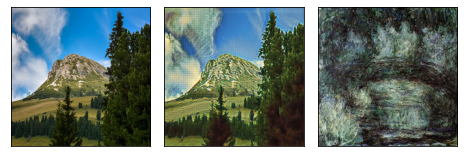

 13%|█▎        | 201/1500 [05:02<32:32,  1.50s/it]
Discriminator X loss: 0.502902275442484
Discriminator Y loss: 0.5185137927828737
Generator loss:     5.874061278442838


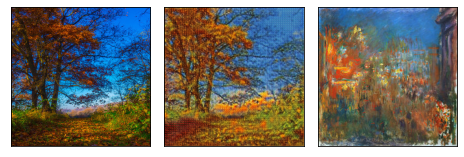

 17%|█▋        | 251/1500 [06:17<31:06,  1.49s/it]
Discriminator X loss: 0.5000845142213471
Discriminator Y loss: 0.510811308524998
Generator loss:     5.8357845758536895


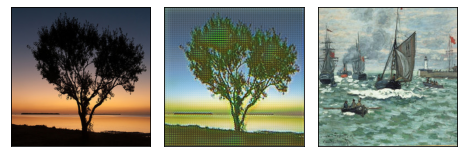

 20%|██        | 301/1500 [07:32<29:57,  1.50s/it]
Discriminator X loss: 0.5051196495757942
Discriminator Y loss: 0.5113548967628384
Generator loss:     5.878819910790833


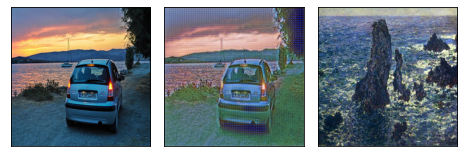

 23%|██▎       | 351/1500 [08:47<28:35,  1.49s/it]
Discriminator X loss: 0.5070639388513701
Discriminator Y loss: 0.5111423798351207
Generator loss:     5.8172800894136785


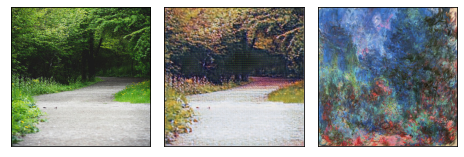

 27%|██▋       | 401/1500 [10:02<27:18,  1.49s/it]
Discriminator X loss: 0.5082639216670669
Discriminator Y loss: 0.5200834503940811
Generator loss:     5.78217351704167


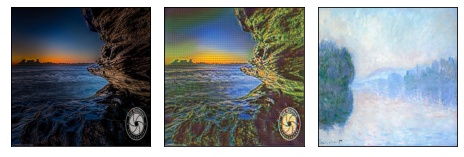

 30%|███       | 451/1500 [11:17<26:09,  1.50s/it]
Discriminator X loss: 0.5099338949090098
Discriminator Y loss: 0.5239783689346652
Generator loss:     5.777404519248167


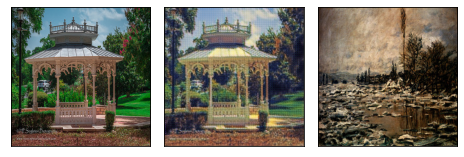

 33%|███▎      | 501/1500 [12:32<24:59,  1.50s/it]
Discriminator X loss: 0.5094033488464689
Discriminator Y loss: 0.5195062871643169
Generator loss:     5.758020494750398


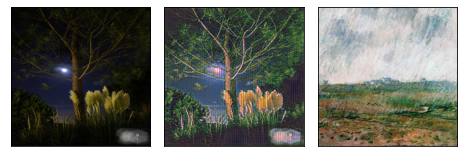

 37%|███▋      | 551/1500 [13:47<23:38,  1.49s/it]
Discriminator X loss: 0.5058715463279596
Discriminator Y loss: 0.5156993175469704
Generator loss:     5.727274278979985


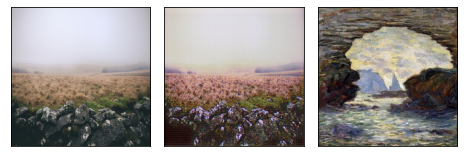

 40%|████      | 601/1500 [15:02<22:19,  1.49s/it]
Discriminator X loss: 0.5073905377563541
Discriminator Y loss: 0.5183878275263627
Generator loss:     5.729428749909615


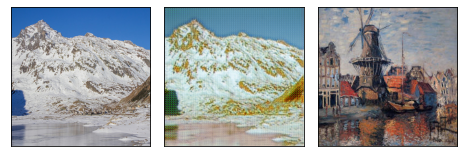

 43%|████▎     | 651/1500 [16:17<21:04,  1.49s/it]
Discriminator X loss: 0.5095481991928111
Discriminator Y loss: 0.5162300130841644
Generator loss:     5.719654951959894


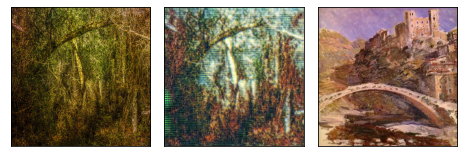

 47%|████▋     | 701/1500 [17:31<19:46,  1.48s/it]
Discriminator X loss: 0.5063467226954398
Discriminator Y loss: 0.5169884331906999
Generator loss:     5.7278990058518


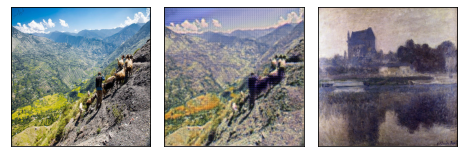

 50%|█████     | 751/1500 [18:46<18:35,  1.49s/it]
Discriminator X loss: 0.5046596402394152
Discriminator Y loss: 0.5124048901233231
Generator loss:     5.72369643438672


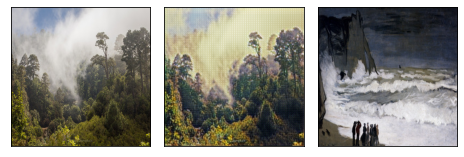

 53%|█████▎    | 801/1500 [20:01<17:17,  1.48s/it]
Discriminator X loss: 0.5025320358844136
Discriminator Y loss: 0.512144403646092
Generator loss:     5.710159650902623


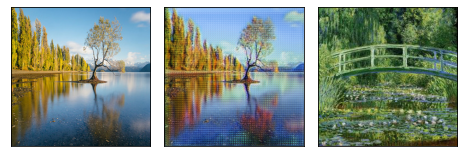

 57%|█████▋    | 851/1500 [21:15<16:05,  1.49s/it]
Discriminator X loss: 0.5056666232706797
Discriminator Y loss: 0.5110847784379184
Generator loss:     5.7101625009373125


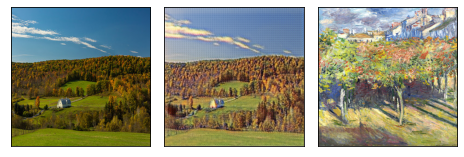

 60%|██████    | 901/1500 [22:30<14:52,  1.49s/it]
Discriminator X loss: 0.5044552733032208
Discriminator Y loss: 0.5110136474979903
Generator loss:     5.706769672535633


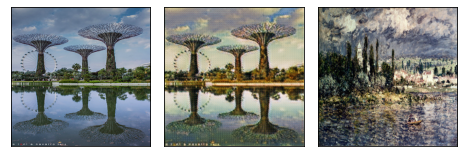

 63%|██████▎   | 951/1500 [23:44<13:37,  1.49s/it]
Discriminator X loss: 0.5228614703518045
Discriminator Y loss: 0.507750259428339
Generator loss:     5.696848488255129


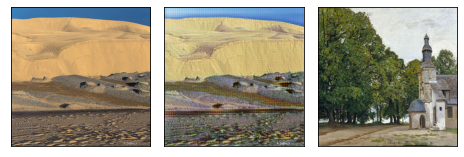

 67%|██████▋   | 1001/1500 [24:59<12:19,  1.48s/it]
Discriminator X loss: 0.5212978438532853
Discriminator Y loss: 0.5053903548666587
Generator loss:     5.698706079315353


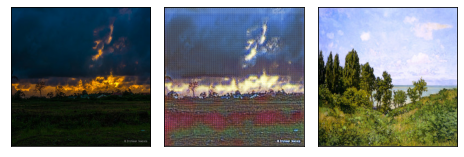

 70%|███████   | 1051/1500 [26:13<11:04,  1.48s/it]
Discriminator X loss: 0.5210190307451757
Discriminator Y loss: 0.5065089051073841
Generator loss:     5.685801455228245


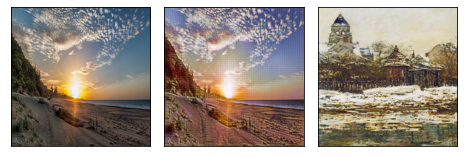

 73%|███████▎  | 1101/1500 [27:27<09:49,  1.48s/it]
Discriminator X loss: 0.5196247912848624
Discriminator Y loss: 0.5034321852529136
Generator loss:     5.6941973286038845


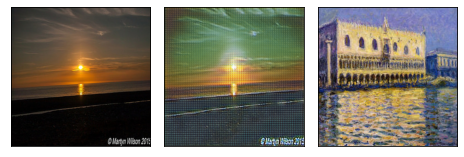

 77%|███████▋  | 1151/1500 [28:42<08:37,  1.48s/it]
Discriminator X loss: 0.5176869107622307
Discriminator Y loss: 0.5018326087938144
Generator loss:     5.678040390735497


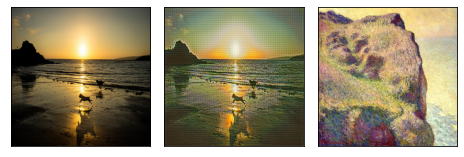

 80%|████████  | 1201/1500 [29:56<07:22,  1.48s/it]
Discriminator X loss: 0.5169811066112897
Discriminator Y loss: 0.5018894280416334
Generator loss:     5.684572768350327


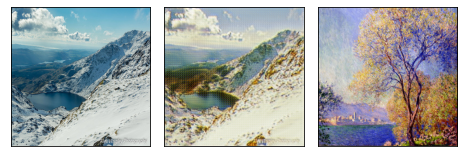

 83%|████████▎ | 1251/1500 [31:11<06:09,  1.48s/it]
Discriminator X loss: 0.515993069636998
Discriminator Y loss: 0.500314336883531
Generator loss:     5.683750787799021


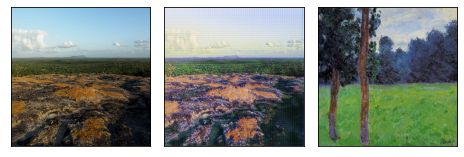

 87%|████████▋ | 1301/1500 [32:25<04:54,  1.48s/it]
Discriminator X loss: 0.5150360456717235
Discriminator Y loss: 0.5011241381227696
Generator loss:     5.678494231138296


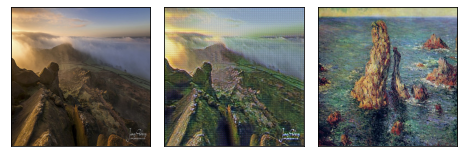

 90%|█████████ | 1351/1500 [33:39<03:40,  1.48s/it]
Discriminator X loss: 0.514735386407018
Discriminator Y loss: 0.5021924509092625
Generator loss:     5.675800671496275


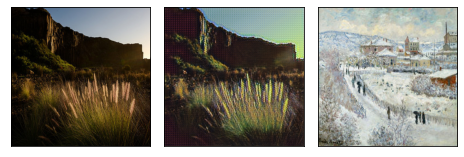

 93%|█████████▎| 1401/1500 [34:53<02:25,  1.47s/it]
Discriminator X loss: 0.5138890471423762
Discriminator Y loss: 0.5018985392785047
Generator loss:     5.674705629600617


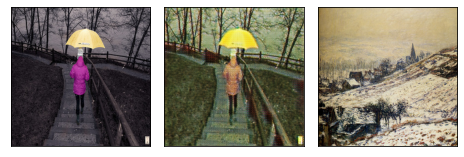

 97%|█████████▋| 1451/1500 [36:07<01:12,  1.48s/it]
Discriminator X loss: 0.5130335026844914
Discriminator Y loss: 0.5018931984526589
Generator loss:     5.666255715302481


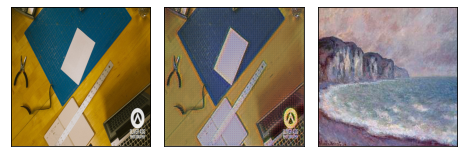

100%|██████████| 1500/1500 [37:20<00:00,  1.49s/it]
Discriminator X loss: 0.5128324007118742
Discriminator Y loss: 0.5029098469639818
Generator loss:     5.673616062482198
Saved checkpoint.


In [34]:
import IPython.display
import tqdm
from cyclegan import train_batch, save_checkpoint

num_epochs = 5

# if os.path.isfile(f'{checkpoint_file_final}.pt'):
#     print(f'*** Loading final checkpoint file {checkpoint_file_final} instead of training')
#     num_epochs = 0
#     gen = torch.load(f'{checkpoint_file_final}.pt', map_location=device)
#     checkpoint_file = checkpoint_file_final

try:
    dscX_avg_losses, dscY_avg_losses, gen_avg_losses = [], [], []
    for epoch_idx in range(num_epochs):
        # We'll accumulate batch losses and show an average once per epoch.
        dscX_losses, dscY_losses, gen_losses = [], [], []
        print(f'--- EPOCH {epoch_idx+1}/{num_epochs} ---')

        with tqdm.tqdm(total=len(dl_train.batch_sampler), file=sys.stdout) as pbar:
            for batch_idx, (x_data, y_data) in enumerate(dl_train):
                x_data, y_data = x_data.to(device), y_data.to(device)
                dscX_loss, dscY_loss, gen_loss = train_batch(
                    dscY, dscX, genXY, genYX,
                    dsc_loss_fn, gen_loss_fn, cyc_consistency_loss_fn, idt_loss_fn,
                    dsc_optimizer, gen_optimizer,
                    x_data, y_data)
                dscX_losses.append(dscY_loss)
                dscY_losses.append(dscX_loss)
                gen_losses.append(gen_loss)
                pbar.update()
            
                if batch_idx % 50 == 0:
                    print(f'\nDiscriminator X loss: {np.mean(dscX_losses)}')
                    print(f'Discriminator Y loss: {np.mean(dscY_losses)}')
                    print(f'Generator loss:     {np.mean(gen_losses)}')

                    with torch.no_grad():
                        y_fake = genXY(x_data).cpu()
                        t_to_display = torch.cat([x_data.cpu(), y_fake.cpu(), y_data.cpu()])
                        fig, _ = plot.tensors_as_images(t_to_display.detach())#figsize=(6,2))
                        IPython.display.display(fig)
                        plt.close(fig)

        dscX_avg_losses.append(np.mean(dscX_losses))
        dscY_avg_losses.append(np.mean(dscY_losses))
        gen_avg_losses.append(np.mean(gen_losses))
        print(f'Discriminator X loss: {dscX_avg_losses[-1]}')
        print(f'Discriminator Y loss: {dscY_avg_losses[-1]}')
        print(f'Generator loss:     {gen_avg_losses[-1]}')
        
        if save_checkpoint(gen, dscX_avg_losses, dscY_avg_losses, gen_avg_losses, checkpoint_file):
            print(f'Saved checkpoint.')
            
#         samples = gen.sample(5, with_grad=False)
#         fig, _ = plot.tensors_as_images(samples.cpu(), figsize=(6,2))
#         IPython.display.display(fig)
#         plt.close(fig)
except KeyboardInterrupt as e:
    print('\n *** Training interrupted by user')

In [59]:
if save_checkpoint(genXY, dscX_avg_losses, dscY_avg_losses, gen_avg_losses, 'checkpoints/cycgan-genXY'):
    print(f'Saved checkpoint.')

Saved checkpoint.


In [60]:
if save_checkpoint(genYX, dscX_avg_losses, dscY_avg_losses, gen_avg_losses, 'checkpoints/cycgan-genYX'):
    print(f'Saved checkpoint.')

Saved checkpoint.


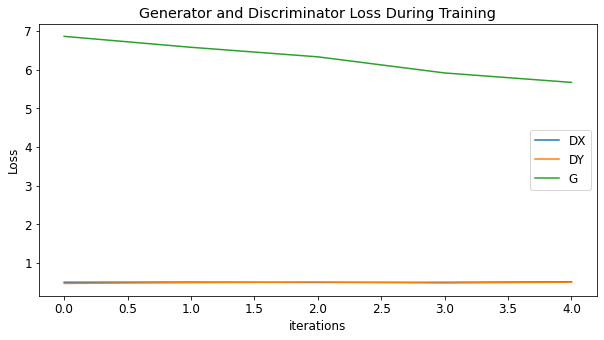

In [61]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(dscX_avg_losses,label="DX")
plt.plot(dscY_avg_losses,label="DY")
plt.plot(gen_avg_losses,label="G")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [62]:
# Plot images from best or last model
if os.path.isfile('checkpoints/cycgan-genXY.pt'):
    gen1 = torch.load('checkpoints/cycgan-genXY.pt', map_location=device)

if os.path.isfile('checkpoints/cycgan-genYX.pt'):
    gen2 = torch.load('checkpoints/cycgan-genYX.pt', map_location=device)

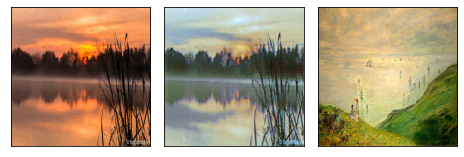

In [63]:
x_real, y_real = next(iter(dl_train))
y_fake = gen1(x_real.cuda()).cpu()
t_to_display = torch.cat([x_real.cpu(), y_fake.cpu(), y_real.cpu()])
fig, _ = plot.tensors_as_images(t_to_display.detach())#figsize=(6,2))

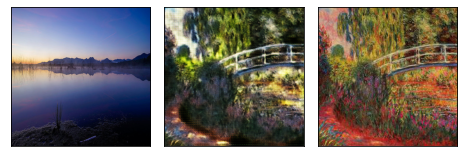

In [65]:
x_real, y_real = next(iter(dl_train))
x_fake = gen2(y_real.cuda()).cpu()
t_to_display = torch.cat([x_real.cpu(), x_fake.cpu(), y_real.cpu()])
fig, _ = plot.tensors_as_images(t_to_display.detach())#figsize=(6,2))